# Sentinel-2 L2A NDWI Time Series via Sentinel-Hub Process API

### _Import functional dependencies and add repository source directory to system path_

In [1]:
import os
import yaml
from munch import munchify

In [2]:
# define repo name and get root working directory
repo = 'process-api'
root_path = os.getcwd()[ 0 : os.getcwd().find( repo ) + len ( repo )]
root_path

'C:\\Users\\crwil\\Documents\\GitHub\\sentinelhub\\process-api'

In [3]:
# get path to configuration files
cfg_path = os.path.join( root_path, 'cfg' )
cfg_path = os.path.join( cfg_path, 'sentinel-2' )
cfg_path

'C:\\Users\\crwil\\Documents\\GitHub\\sentinelhub\\process-api\\cfg\\sentinel-2'

### _Load configuration file from repository cfg sub-directory_ 

In [4]:
# get pathname to configuration file
cfg_file = os.path.join( cfg_path, 's2-timeseries-ndwi.yml' )

In [5]:
# print contents of configuration file
with open( cfg_file ) as f:
    print ( f.read() )

request:
    evalscript: |
                //VERSION=3              
                // color ramps
                var colorRamp1 = [
                    [0, 0xFFFFFF],
                    [1, 0x008000]
                ];
                var colorRamp2 = [
                    [0, 0xFFFFFF],
                    [1, 0x0000CC]
                ];
                let viz1 = new ColorRampVisualizer(colorRamp1);
                let viz2 = new ColorRampVisualizer(colorRamp2);
                
                function setup() {
                    return {
                        input: [{
                            bands: [ "B03", "B08" ],
                        }],
                        output: {
                            bands: 3,
                        }
                    }
                }                
                function evaluatePixel(samples) {
                    // compute ndwi: (B03 - B08) / (B03 + B08)
                    var denom = (samples.B03 + samples.B08)
   

In [6]:
# load cfg file using yaml parser
with open( cfg_file, 'r' ) as f:
    config = munchify( yaml.safe_load( f ) )

### _Define bounding box collocated with Veneto Region in northeast Italy_ 

In [7]:
# define min and max latlons
coords = 12.305786,45.412510,12.480606,45.530632
resolution = 10

In [8]:
# create instance of shclient class
from processapi import Client
client = Client( config )

C:\Users\crwil\AppData\Roaming\Python\Python39\site-packages\sentinelhub\sh_utils.py:90: SHDeprecationWarning: Parameter base_url is deprecated and will soon be removed. Instead set config.sh_base_url = base_url and provide it with config parameter
  warnings.warn('Parameter base_url is deprecated and will soon be removed. Instead set '


In [9]:
# get utm bbox
bbox = client.getBoundingBox( coords )
print ( bbox, bbox.crs.value )

289184.9491748594,5032307.959419286,303275.657802195,5044987.169394127 32633


In [10]:
# get aoi image dimensions
client.getBoxDimensions( bbox, resolution )

(1409, 1268)

### _Identify S2 scenes acquired between May and June 2020 satisfying cloud cover filter conditions_

In [11]:
# pick a few dates
from datetime import datetime
timeframe = { 'start' : datetime( 2020, 5, 2, 0, 0, 0 ), 
                'end' : datetime( 2020, 6, 23, 23, 59, 59 ) }

In [12]:
# get S2 acquisitions between start / end dates satisfying filter conditions
timestamps = client.getDatasetTimeStamps ( config.request.inputs[ 0 ], bbox, timeframe )
timestamps

C:\Users\crwil\AppData\Roaming\Python\Python39\site-packages\sentinelhub\sh_utils.py:90: SHDeprecationWarning: Parameter base_url is deprecated and will soon be removed. Instead set config.sh_base_url = base_url and provide it with config parameter
  warnings.warn('Parameter base_url is deprecated and will soon be removed. Instead set '


[datetime.datetime(2020, 5, 3, 10, 18, 3, tzinfo=tzutc()),
 datetime.datetime(2020, 5, 25, 10, 8, 19, tzinfo=tzutc()),
 datetime.datetime(2020, 6, 12, 10, 18, 9, tzinfo=tzutc()),
 datetime.datetime(2020, 6, 22, 10, 18, 9, tzinfo=tzutc())]

### _Download NDWI time series using Process API client_ 

In [13]:
# get time series
response = client.getTimeSeries ( bbox, timeframe, resolution )
response._df

,default,time
0,"[[[182, 219, 182], [187, 221, 187], [156, 206,...",2020-05-03 10:18:03+00:00
1,"[[[0, 0, 204], [0, 0, 204], [0, 0, 204], [0, 0...",2020-05-25 10:08:19+00:00
2,"[[[184, 219, 184], [173, 214, 173], [170, 213,...",2020-06-12 10:18:09+00:00
3,"[[[195, 225, 195], [164, 210, 164], [154, 205,...",2020-06-22 10:18:09+00:00


### _Visualise NDWI time series_

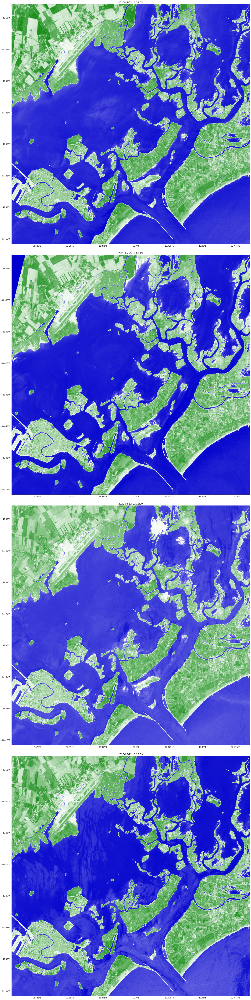

In [14]:
# plot time series
response.plotImages( 'default', alpha={ 'data' : 1.0, 'grid' : 0.0 } )

C:\Users\crwil\AppData\Roaming\Python\Python39\site-packages\cartopy\crs.py:825: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
C:\Users\crwil\AppData\Roaming\Python\Python39\site-packages\cartopy\crs.py:877: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
C:\Users\crwil\AppData\Roaming\Python\Python39\site-packages\cartopy\crs.py:944: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:


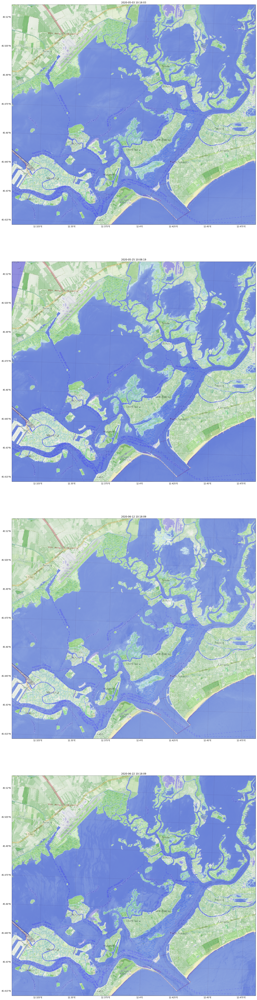

In [15]:
# plot time series
response.plotImages( 'default', osm_zoom=13 )